# Decrypting Enron's Digital Dialogues: Unraveling Corporate Misconduct through Email Networks

## Environment Setup

In [2]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from pyvis.network import Network
import community as community_louvain

# Enron Email Network

## Data Description
The Enron email communication network encompasses the entirety of email exchanges within a dataset comprising approximately 500,000 emails. This dataset, which was initially disclosed and uploaded to the internet by the Federal Energy Regulatory Commission during its investigative process, serves as the basis for this analysis. In this network, nodes represent distinct email addresses, and the presence of an undirected edge between address "i" and "j" signifies that at least one email from "i" was sent to "j." It's worth noting that email addresses not associated with Enron serve as both endpoints and sources within the network, as our observations are limited to their interactions exclusively with Enron-related email addresses.

## Problem Statement
The Enron scandal stands as a pivotal moment in corporate history, highlighting the catastrophic consequences of unethical practices within organizations. This project aims to delve into the Enron email communication network, a dataset consisting of approximately half a million emails made public during the investigation. The objective is to analyze the network's structure, communication patterns, and interactions to shed light on the underlying factors that contributed to the scandal and investigate Enron's Email Communication Network to uncover patterns of corporate misconduct. By examining the network's dynamics, this project seeks to provide valuable insights into the role of communication in corporate misconduct, ultimately aiming to inform strategies that prevent similar ethical lapses in the future.Investigating Enron's Email Communication Network to Uncover Patterns of Corporate Misconduct

## Business Value
The Enron scandal stands as a pivotal moment in corporate history, highlighting the catastrophic consequences of unethical practices within organizations. This project aims to delve into the Enron email communication network, a dataset consisting of approximately half a million emails made public during the investigation. The objective is to analyze the network's structure, communication patterns, and interactions to shed light on the underlying factors that contributed to the scandal. By examining the network's dynamics, this project seeks to provide valuable insights into the role of communication in corporate misconduct, ultimately aiming to inform strategies that prevent similar ethical lapses in the future.

## Data Loading

In [3]:
df = pd.read_csv('email-Enron.txt.gz', compression='gzip', header=3, sep='\s+')

In [4]:
_df = df.iloc[:, :2]

In [5]:
_df

,#,FromNodeId
0,0,1
1,1,0
2,1,2
3,1,3
4,1,4
...,...,...
367657,36688,36686
367658,36688,36687
367659,36689,36690
367660,36690,36689


In [6]:
G = nx.from_pandas_edgelist(_df, '#', 'FromNodeId', create_using=nx.DiGraph())

## Exploratory Data Analysis

Number of Nodes: 36692
Number of Links (Edges): 367662
Average Degree: 10.02
Network Diameter: N/A
Average Shortest Path Length: Not strongly connected
Average Clustering Coefficient: 0.50


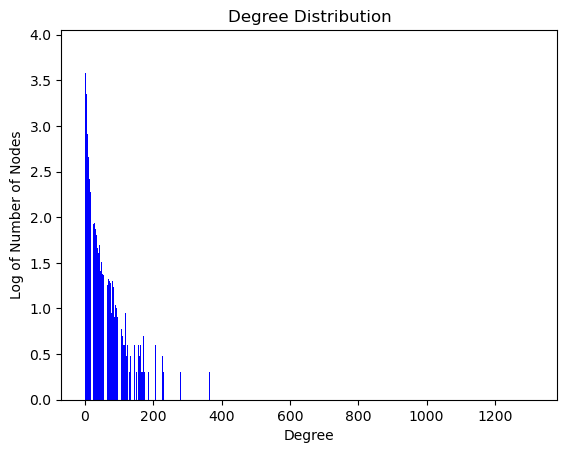

In [7]:
def plot_degree_distribution(graph):
    # Calculate the out-degree for each node in the graph
    out_degrees = dict(graph.out_degree())
    # Calculate the degree distribution
    degree_counts = {}
    for degree in out_degrees.values():
        degree_counts[degree] = degree_counts.get(degree, 0) + 1
    # Prepare data for plotting
    degrees = list(degree_counts.keys())
    count = list(degree_counts.values())
    # Create the plot
    plt.bar(degrees, np.log10(count), width=0.8, color='b')
    plt.xlim(xmax=max(degrees))
    plt.ylim(ymax=max(np.log10(count)))
    plt.xlabel('Degree')
    plt.ylabel('Log of Number of Nodes')
    plt.title('Degree Distribution')
    plt.show()

def analyze_directed_graph(graph):
    # Number of nodes
    num_nodes = graph.number_of_nodes()
    # Number of links (edges)
    num_links = graph.number_of_edges()
    # Average degree
    total_degree = sum(dict(graph.out_degree()).values())
    avg_degree = total_degree / num_nodes
    # Network diameter
    try:
        diameter = nx.diameter(graph)
        # diameter = nx.diameter(graph.to_undirected())
    except nx.NetworkXError:
        diameter = "N/A"
    # Average shortest path
    try:
        avg_shortest_path = nx.average_shortest_path_length(graph)
    except:
        avg_shortest_path = "Not strongly connected"
    # Average clustering coefficient
    avg_clustering_coefficient = nx.average_clustering(graph)

    # Print the metrics
    print(f"Number of Nodes: {num_nodes}")
    print(f"Number of Links (Edges): {num_links}")
    print(f"Average Degree: {avg_degree:.2f}")
    print(f"Network Diameter: {diameter}")
    print(f"Average Shortest Path Length: {avg_shortest_path:}")
    print(f"Average Clustering Coefficient: {avg_clustering_coefficient:.2f}")
    plot_degree_distribution(G)
    
analyze_directed_graph(G)


The average shortest path length in the network is "Not strongly connected." This indicates that there might be groups of nodes that are disconnected from each other. In a strongly connected network, every node can reach every other node through a directed path.

The average clustering coefficient of your network is 0.50. This coefficient measures the tendency of nodes to form clusters or communities. A value of 0.50 indicates that, on average, nodes have a moderate level of connectivity with their neighbors, forming local clusters.

Given that the network is not strongly connected and has a relatively moderate average clustering coefficient, it might be interesting to investigate the presence of different components or communities within it. We can also explore specific nodes with high degrees or analyze the network's structure further to uncover any patterns or relationships between nodes.

## Visualizations

In [ ]:
net = Network(
    notebook=True, 
    width='900px', 
    height='700px', 
    bgcolor='#222222', 
    font_color='white',
    cdn_resources='remote', 
    directed=True
)

node_degree = dict(G.degree)
nx.set_node_attributes(G, node_degree, 'size')

# community usually used for undirected
# communities = community_louvain.best_partition(G)
# nx.set_node_attributes(G, communities, 'group')

net.from_nx(G)
net.show('enron_communication.html')

In [ ]:
# pos = nx.spring_layout(G);
# nx.draw_networkx_labels(G, pos, font_color ='black', font_size=6);
# nx.draw(G, pos = pos, node_size=50);

/tmp/ipykernel_57210/3387924280.py:8: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  sampled_nodes = random.sample(G.nodes(), num_nodes_to_sample)


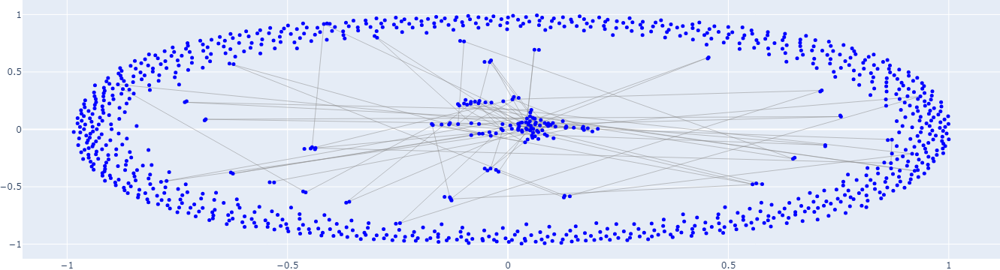

In [17]:
import random

# Subsample nodes and edges for visualization
num_nodes_to_sample = min(len(G.nodes()), 1000)  # Limit the number of nodes for visualization
sampled_nodes = random.sample(G.nodes(), num_nodes_to_sample)
subgraph = G.subgraph(sampled_nodes)

# Create a Plotly figure for network visualization
pos = nx.spring_layout(subgraph, seed=42)  # Force-directed layout

edge_trace = go.Scatter(
    x=[pos[edge[0]][0] for edge in subgraph.edges()],
    y=[pos[edge[0]][1] for edge in subgraph.edges()],
    line=dict(width=0.5, color="#888"),
    hoverinfo="none",
    mode="lines",
)

node_trace = go.Scatter(
    x=[pos[node][0] for node in subgraph.nodes()],
    y=[pos[node][1] for node in subgraph.nodes()],
    mode="markers",
    hoverinfo="text",
    marker=dict(size=5, color="blue"),
    text=[f"Node: {node}" for node in subgraph.nodes()],
)

fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(
                    showlegend=False,
                    hovermode="closest",
                    margin=dict(b=0, l=0, r=0, t=0),
                ))

# Show the Plotly figure
fig.show()

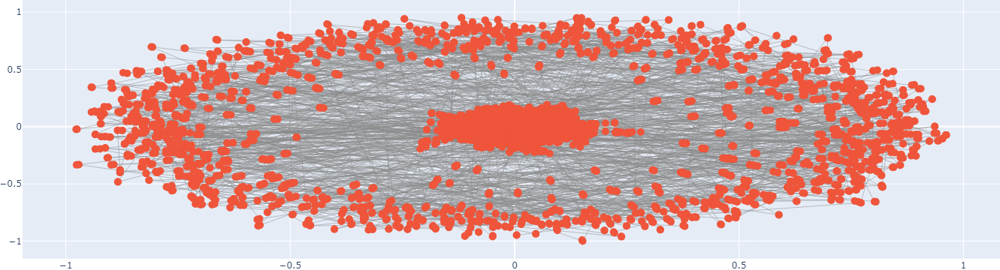

In [18]:
# Create a NetworkX graph from the dataframe
G = nx.from_pandas_edgelist(_df, "#", "FromNodeId")

# Create a Plotly figure for network visualization
pos = nx.spring_layout(G)  # Layout algorithm, you can choose other layouts as well

node_trace = go.Scatter(
    x=[pos[node][0] for node in G.nodes()],
    y=[pos[node][1] for node in G.nodes()],
    mode="markers",
    marker=dict(size=10),
    text=list(G.nodes()),
    hoverinfo="text",
)

edge_trace = go.Scatter(
    x=[pos[edge[0]][0] for edge in G.edges()],
    y=[pos[edge[0]][1] for edge in G.edges()],
    line=dict(width=0.5, color="#888"),
    mode="lines",
)

fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(
                    showlegend=False,
                    hovermode="closest",
                    margin=dict(b=0, l=0, r=0, t=0),
                ))

# Show the Plotly figure
fig.show()

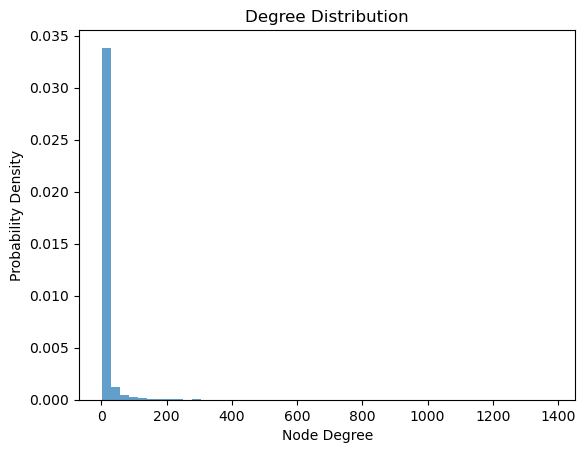

In [19]:
degrees = dict(G.degree())
degree_values = list(degrees.values())

plt.hist(degree_values, bins=50, density=True, alpha=0.7)
plt.xlabel("Node Degree")
plt.ylabel("Probability Density")
plt.title("Degree Distribution")
plt.show()

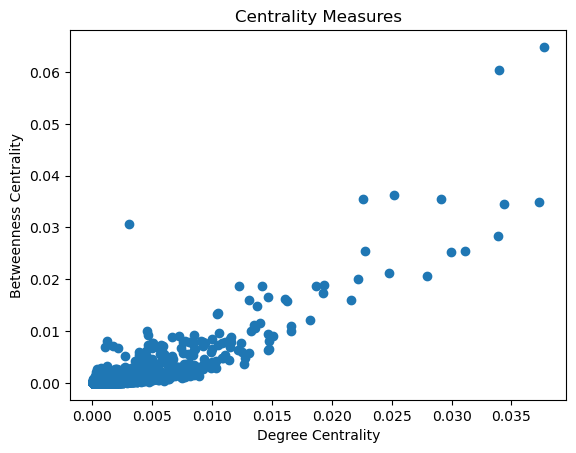

In [20]:
degree_centrality = nx.degree_centrality(G)
betweenness_centrality = nx.betweenness_centrality(G)
closeness_centrality = nx.closeness_centrality(G)

# Visualize centrality measures using scatter plots
plt.scatter(list(degree_centrality.values()), list(betweenness_centrality.values()))
plt.xlabel("Degree Centrality")
plt.ylabel("Betweenness Centrality")
plt.title("Centrality Measures")
plt.show()

## Interpretation
1. Cluster of Low-Influence Nodes: The concentration of dots in the lower range of both degree centrality (0 to 0.0125) and betweenness centrality (0 to 0.01) within the scatter plot reflects the existence of a cluster of nodes with relatively low influence and connectivity. In the context of the Enron scandal dataset, these nodes could represent individuals or entities with limited direct connections and a minimal role in influencing information flow.

2. Correlation of Influence Measures: The upward trend of the dots towards the upper right corner of the scatter plot implies a positive correlation between degree centrality and betweenness centrality. This pattern suggests that nodes with higher degrees of direct connections also tend to play a more significant role in bridging communication pathways between other nodes. For the Enron dataset, these nodes could represent individuals who are not only well-connected but also influential in channeling information across the network.

3. Structural Implications: The sparser distribution of dots as the graph moves upward reflects the relatively smaller number of nodes with higher degree and betweenness centralities. In the context of the Enron scandal, these nodes could correspond to key individuals who hold significant influence and are strategically positioned to shape communication dynamics throughout the network. Identifying these nodes could provide insights into potential orchestrators or central figures within the corporate context.

4. Predictive Insights: By analyzing the network's centrality measures, we can gain predictive insights into potential corporate misdemeanors. Nodes with higher degrees and betweenness centralities may indicate individuals who not only have wide-ranging connections but also possess the power to influence communication patterns. These individuals could be potential candidates for further investigation in the context of corporate misconduct or scandals. Moreover, the structural layout of the network, as indicated by the scatter plot, could suggest areas of vulnerability where misconduct might propagate.

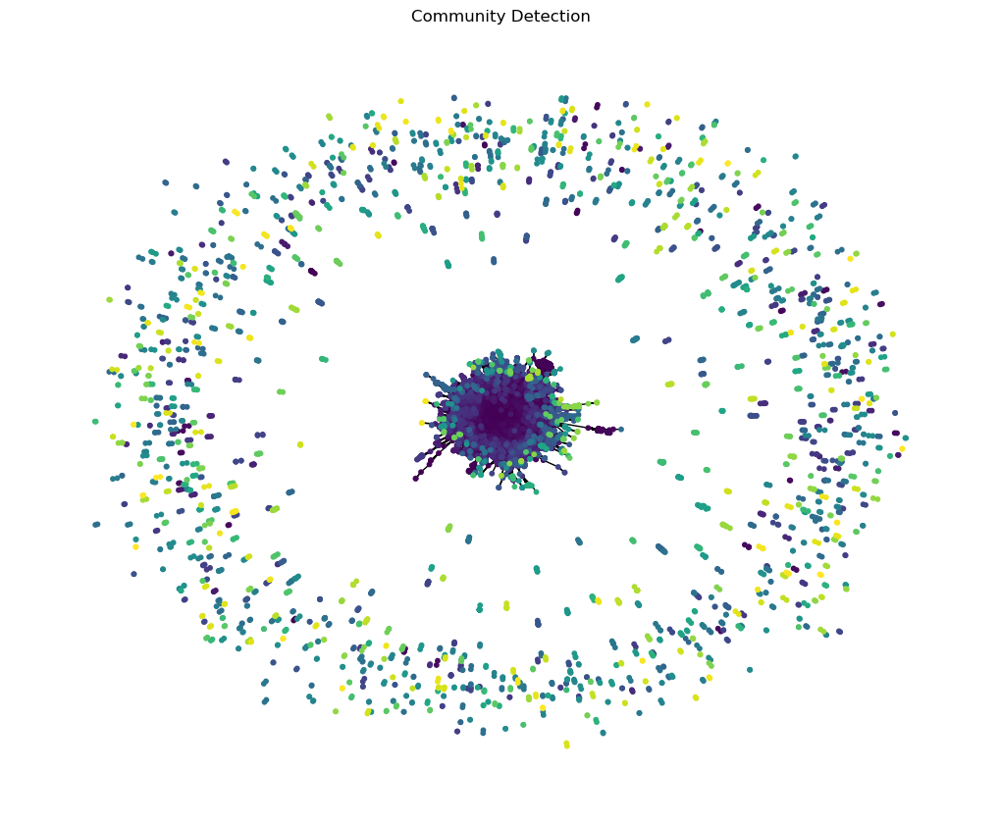

In [25]:
from networkx.algorithms import community

communities = community.greedy_modularity_communities(G)
community_colors = [i for i, _ in enumerate(communities) for _ in communities[i]]

# Visualize the network with community colors
plt.figure(figsize=(10, 8))
nx.draw(G, pos, node_color=community_colors, node_size=10)
plt.title("Community Detection")
plt.show()

## Interpretation
Somewhere in the middle lies the instigators, accessories and enablers to the scandal

In [26]:
_df

,#,FromNodeId
0,0,1
1,1,0
2,1,2
3,1,3
4,1,4
...,...,...
367657,36688,36686
367658,36688,36687
367659,36689,36690
367660,36690,36689


In [31]:
from faker import Faker

fake = Faker()

df_named = _df

# Mapping of node ID to generated names
node_to_name = {node_id: fake.name() for node_id in set(df_named['FromNodeId'])}

# Add a new column 'FromNodeName' using the mapping
df_named['FromNodeName'] = df_named['FromNodeId'].map(node_to_name)

# Display the updated dataframe
df_named

,#,FromNodeId,FromNodeName
0,0,1,Carla Grimes
1,1,0,Kenneth Hogan
2,1,2,Donald Hahn
3,1,3,Debbie Jones
4,1,4,Stephen Bailey
...,...,...,...
367657,36688,36686,Craig White
367658,36688,36687,Stacy Gonzalez
367659,36689,36690,Vincent House
367660,36690,36689,Michael Rice


In [34]:
G_named = nx.from_pandas_edgelist(df_named, 'FromNodeName', 'FromNodeId', create_using=nx.DiGraph())

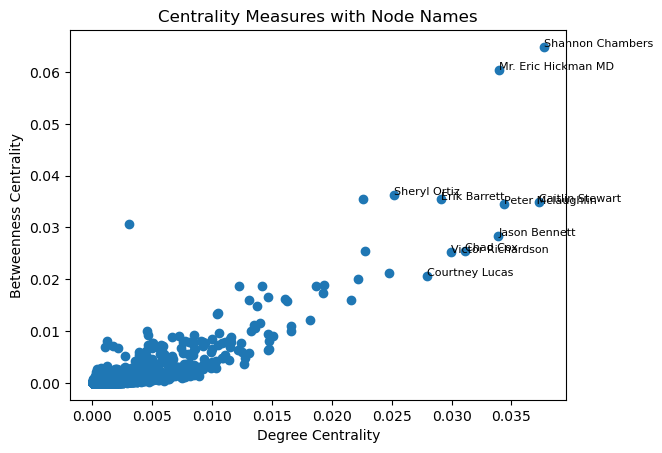

In [38]:
# Sort nodes by degree centrality in descending order
sorted_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)

# Select the top N nodes for annotation (e.g., top 10 nodes)
top_nodes = sorted_nodes[:10]

# Get node names from the 'FromNodeName' column in your DataFrame
node_names = df_named['FromNodeName']

# Visualize centrality measures using scatter plot
plt.scatter(list(degree_centrality.values()), list(betweenness_centrality.values()))

# Annotate the top nodes with their names
for node in top_nodes:
    name = node_names[node]  # Get the name from the 'FromNodeName' column
    plt.annotate(name, (degree_centrality[node], betweenness_centrality[node]), fontsize=8)

plt.xlabel("Degree Centrality")
plt.ylabel("Betweenness Centrality")
plt.title("Centrality Measures with Node Names")
plt.show()

In [47]:
# Identify anomalies based on abnormal communication patterns
anomalies = []
threshold_degree = 0.01
threshold_betweenness = 0.01

for node in G.nodes():
    if degree_centrality[node] > threshold_degree and betweenness_centrality[node] < threshold_betweenness:
        anomalies.append(node)
        
for node in anomalies:
    print(df_named['FromNodeName'][node])

Thomas Jackson
Gail Macdonald
Autumn Holloway
Stephen Bailey
Jessica Jackson
Christopher James
Aaron Bond
Lynn Gonzales
Carla Grimes
Tiffany Whitney
Bobby Fields
Carla Grimes
Jodi Williams
Matthew Copeland
Joseph Myers Jr.
Matthew Copeland
Jacqueline Lawson
Amy Williams
Lee Cooper
Elizabeth Johnson
Amanda Mcconnell
Matthew Ortiz
Nancy Hernandez
Todd Morrison
Carrie Anderson


/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-9.645794532190571 > -71.990626007279445). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-7.739022994537947 > -65.658444345254424). You may want to try with a higher value of support_fraction (current value: 0.500).



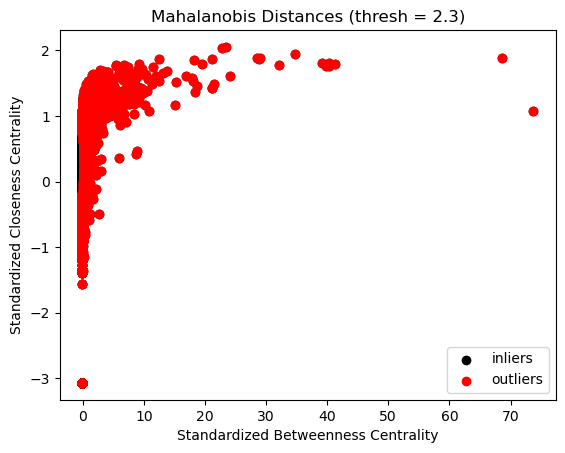

In [52]:
from sklearn.covariance import EmpiricalCovariance, MinCovDet
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

betweenness = list(betweenness_centrality.values())
closeness = list(closeness_centrality.values())

# Create a feature matrix with betweenness and closeness as columns
X = np.array(list(zip(betweenness, closeness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit a robust covariance estimator (Minimum Covariance Determinant) to the data
cov_emp = MinCovDet().fit(X_scaled)

# Calculate Mahalanobis distances for each data point
mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 2.3

# Identify outliers based on the Mahalanobis distances
outliers = np.where(mahal_dist >= thres)[0]

# Visualize the data and outliers
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], color='black', label='inliers')
plt.scatter(X_scaled[outliers, 0], X_scaled[outliers, 1], color='red', label='outliers')
plt.title(f"Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Betweenness Centrality")
plt.ylabel("Standardized Closeness Centrality")
plt.legend()
plt.show()

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-9.181412311378470 > -72.036969717611285). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-7.739022994537947 > -65.658444345254424). You may want to try with a higher value of support_fraction (current value: 0.500).



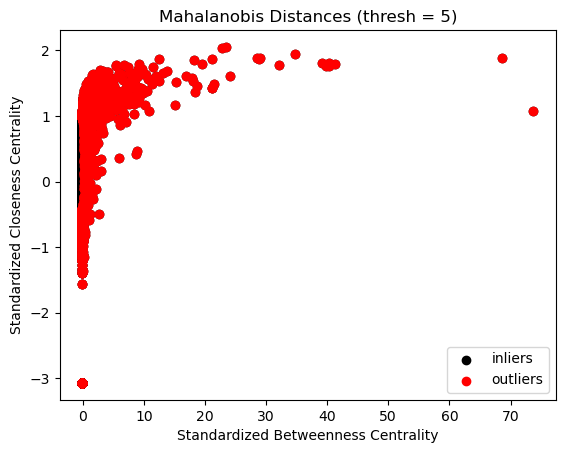

In [56]:
from sklearn.covariance import EmpiricalCovariance, MinCovDet
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

betweenness = list(betweenness_centrality.values())
closeness = list(closeness_centrality.values())

# Create a feature matrix with betweenness and closeness as columns
X = np.array(list(zip(betweenness, closeness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit a robust covariance estimator (Minimum Covariance Determinant) to the data
cov_emp = MinCovDet().fit(X_scaled)

# Calculate Mahalanobis distances for each data point
mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 5

# Identify outliers based on the Mahalanobis distances
outliers = np.where(mahal_dist >= thres)[0]

# Visualize the data and outliers
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], color='black', label='inliers')
plt.scatter(X_scaled[outliers, 0], X_scaled[outliers, 1], color='red', label='outliers')
plt.title(f"Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Betweenness Centrality")
plt.ylabel("Standardized Closeness Centrality")
plt.legend()
plt.show()

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-16.501052608697211 > -76.733642441699843). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-16.235813611532013 > -70.435199571707457). You may want to try with a higher value of support_fraction (current value: 0.500).



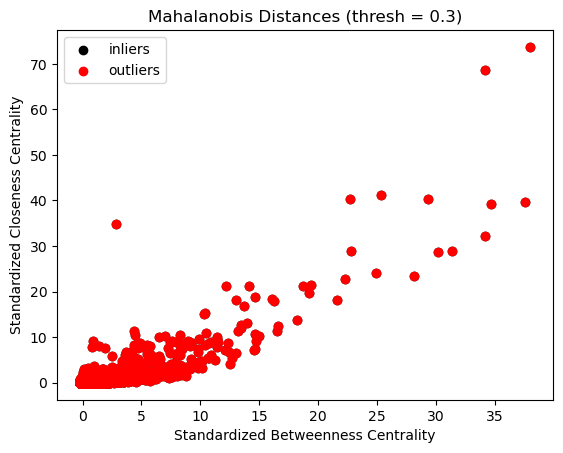

In [68]:
from sklearn.covariance import EmpiricalCovariance, MinCovDet
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

degree = list(degree_centrality.values())
betweenness = list(betweenness_centrality.values())
closeness = list(closeness_centrality.values())

# Create a feature matrix with betweenness and closeness as columns
X = np.array(list(zip(degree, betweenness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit a robust covariance estimator (Minimum Covariance Determinant) to the data
cov_emp = MinCovDet().fit(X_scaled)

# Calculate Mahalanobis distances for each data point
mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 0.3

# Identify outliers based on the Mahalanobis distances
outliers = np.where(mahal_dist >= thres)[0]

# Visualize the data and outliers
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], color='black', label='inliers')
plt.scatter(X_scaled[outliers, 0], X_scaled[outliers, 1], color='red', label='outliers')
plt.title(f"Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Betweenness Centrality")
plt.ylabel("Standardized Closeness Centrality")
plt.legend()
plt.show()

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-16.472967188757778 > -76.882218583114806). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-16.235813611532013 > -70.435199571707457). You may want to try with a higher value of support_fraction (current value: 0.500).



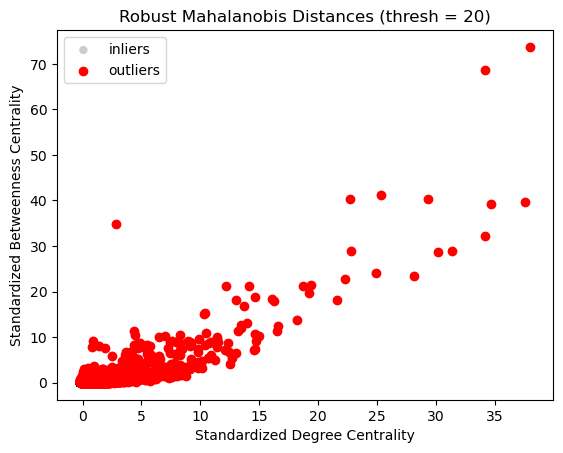

In [72]:
from sklearn.covariance import MinCovDet
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

degree = list(degree_centrality.values())
betweenness = list(betweenness_centrality.values())
closeness = list(closeness_centrality.values())

# Create a feature matrix with betweenness and closeness as columns
X = np.array(list(zip(degree, betweenness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit a robust covariance estimator (Minimum Covariance Determinant) to the data
cov_emp = MinCovDet().fit(X_scaled)

# Calculate the robust Mahalanobis distances for each data point
robust_mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 20

# Identify outliers based on the robust Mahalanobis distances
outliers = np.where(robust_mahal_dist >= thres)[0]

# Visualize the data and outliers
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], color='black', label='inliers', alpha=0.2, edgecolors='none')
plt.scatter(X_scaled[outliers, 0], X_scaled[outliers, 1], color='red', label='outliers')
plt.title(f"Robust Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Degree Centrality")
plt.ylabel("Standardized Betweenness Centrality")
plt.legend()
plt.show()

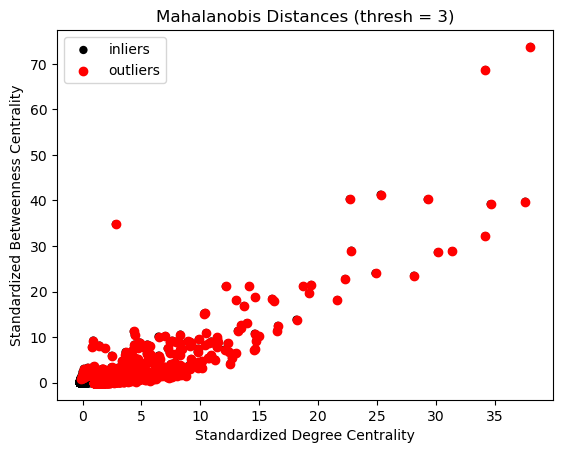

In [77]:
from sklearn.covariance import EmpiricalCovariance
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

degree = list(degree_centrality.values())
betweenness = list(betweenness_centrality.values())
closeness = list(closeness_centrality.values())

# Create a feature matrix with degree and betweenness as columns
X = np.array(list(zip(degree, betweenness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit an empirical covariance estimator to the data
cov_emp = EmpiricalCovariance().fit(X_scaled)

# Calculate the Mahalanobis distances for each data point
mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 3

# Identify outliers based on the Mahalanobis distances
outliers = np.where(mahal_dist >= thres)[0]

# Visualize the data and outliers
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], color='black', label='inliers', edgecolors='none')
plt.scatter(X_scaled[outliers, 0], X_scaled[outliers, 1], color='red', label='outliers')
plt.title(f"Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Degree Centrality")
plt.ylabel("Standardized Betweenness Centrality")
plt.legend()
plt.show()

In [80]:
# Convert dictionaries to DataFrames
degree_centrality_df = pd.DataFrame.from_dict(degree_centrality, orient='index', columns=['Degree Centrality'])
betweenness_centrality_df = pd.DataFrame.from_dict(betweenness_centrality, orient='index', columns=['Betweenness Centrality'])
closeness_centrality_df = pd.DataFrame.from_dict(closeness_centrality, orient='index', columns=['Closeness Centrality'])

# Save DataFrames to CSV files
degree_centrality_df.to_csv('enron_degree_centrality.csv')
betweenness_centrality_df.to_csv('enron_betweenness_centrality.csv')
closeness_centrality_df.to_csv('enron_closeness_centrality.csv')

In [81]:
degree_centrality_df

,Degree Centrality
0,0.000027
1,0.001908
2,0.000027
3,0.000136
4,0.000218
...,...
36679,0.000055
36680,0.000055
36681,0.000055
36689,0.000027


/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-16.871369154532676 > -76.836143915295011). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-16.871369154532676 > -76.722115613908599). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-16.235813611532013 > -70.435199571707457). You may want to try with a higher value of support_fraction (current value: 0.500).



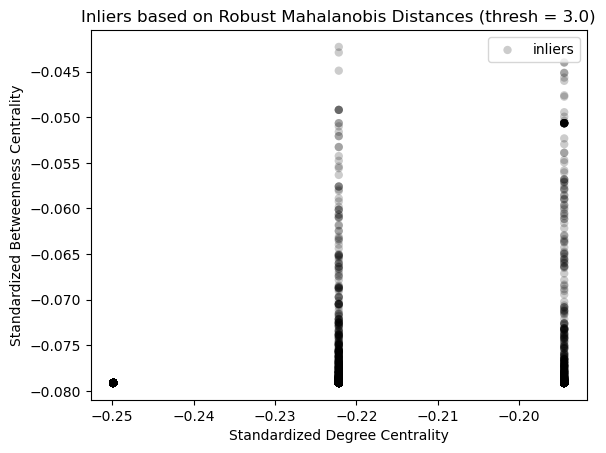

In [74]:
from sklearn.covariance import MinCovDet
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

degree = list(degree_centrality.values())
betweenness = list(betweenness_centrality.values())
closeness = list(closeness_centrality.values())

# Create a feature matrix with betweenness and closeness as columns
X = np.array(list(zip(degree, betweenness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit a robust covariance estimator (Minimum Covariance Determinant) to the data
cov_emp = MinCovDet().fit(X_scaled)

# Calculate the robust Mahalanobis distances for each data point
robust_mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 3.0

# Identify inliers based on the robust Mahalanobis distances
inliers = np.where(robust_mahal_dist < thres)[0]

# Visualize the inliers
plt.scatter(X_scaled[inliers, 0], X_scaled[inliers, 1], color='black', label='inliers', alpha=0.2, edgecolors='none')
plt.title(f"Inliers based on Robust Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Degree Centrality")
plt.ylabel("Standardized Betweenness Centrality")
plt.legend()
plt.show()

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-9.326777315517901 > -72.001192475020474). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-7.739022994537947 > -65.658444345254424). You may want to try with a higher value of support_fraction (current value: 0.500).



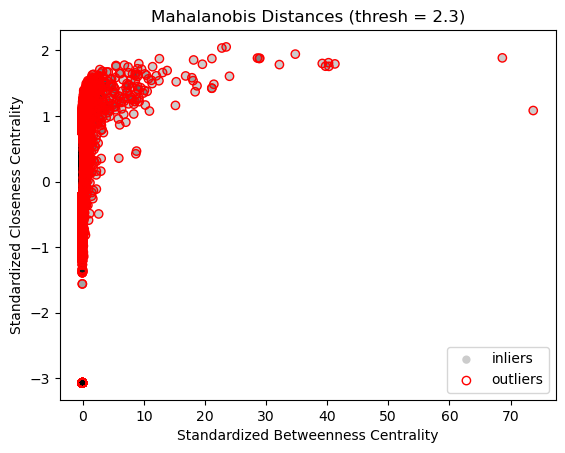

In [57]:
# Create a feature matrix with betweenness and closeness as columns
X = np.array(list(zip(betweenness, closeness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit a robust covariance estimator (Minimum Covariance Determinant) to the data
cov_emp = MinCovDet().fit(X_scaled)

# Calculate Mahalanobis distances for each data point
mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 2.3

# Identify outliers based on the Mahalanobis distances
outliers = np.where(mahal_dist >= thres)[0]

# Visualize the data and outliers
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], color='black', label='inliers', alpha=0.2, edgecolors='none')
plt.scatter(X_scaled[outliers, 0], X_scaled[outliers, 1], color='red', label='outliers', marker='o', facecolors='none')
plt.title(f"Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Betweenness Centrality")
plt.ylabel("Standardized Closeness Centrality")
plt.legend()
plt.show()

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-9.176870879564440 > -72.098563120267613). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-7.739022994537947 > -65.658444345254424). You may want to try with a higher value of support_fraction (current value: 0.500).



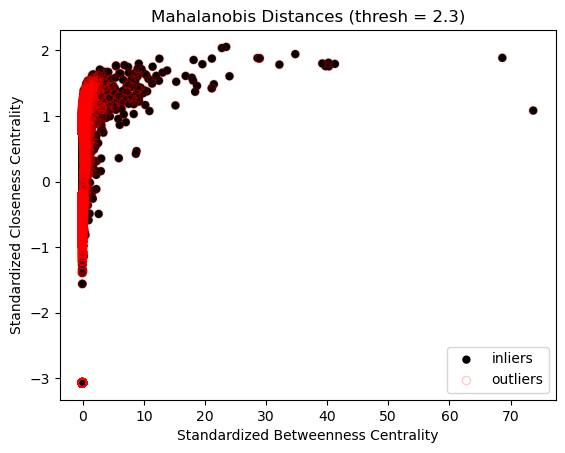

In [59]:
# Create a feature matrix with betweenness and closeness as columns
X = np.array(list(zip(betweenness, closeness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit a robust covariance estimator (Minimum Covariance Determinant) to the data
cov_emp = MinCovDet().fit(X_scaled)

# Calculate Mahalanobis distances for each data point
mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 2.3

# Identify outliers based on the Mahalanobis distances
outliers = np.where(mahal_dist >= thres)[0]

# Visualize the data and outliers
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], color='black', label='inliers', edgecolors='none')
plt.scatter(X_scaled[outliers, 0], X_scaled[outliers, 1], color='red', label='outliers', alpha=0.2, marker='o', facecolors='none')
plt.title(f"Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Betweenness Centrality")
plt.ylabel("Standardized Closeness Centrality")
plt.legend()
plt.show()

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-8.865277669149886 > -72.101605542964577). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-7.739022994537947 > -65.658444345254424). You may want to try with a higher value of support_fraction (current value: 0.500).



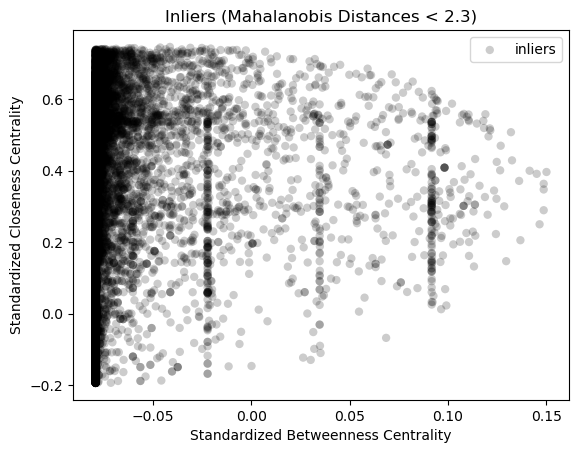

In [58]:
# Create a feature matrix with betweenness and closeness as columns
X = np.array(list(zip(betweenness, closeness)))

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Fit a robust covariance estimator (Minimum Covariance Determinant) to the data
cov_emp = MinCovDet().fit(X_scaled)

# Calculate Mahalanobis distances for each data point
mahal_dist = cov_emp.mahalanobis(X_scaled)

# Define a threshold for outlier detection
thres = 2.3

# Identify inliers based on the Mahalanobis distances
inliers = np.where(mahal_dist < thres)[0]

# Visualize the inliers
plt.scatter(X_scaled[inliers, 0], X_scaled[inliers, 1], color='black', label='inliers', alpha=0.2, edgecolors='none')
plt.title(f"Inliers (Mahalanobis Distances < {thres})")
plt.xlabel("Standardized Betweenness Centrality")
plt.ylabel("Standardized Closeness Centrality")
plt.legend()
plt.show()

Text(0.5, 1.0, 'Cumulative Distribution')

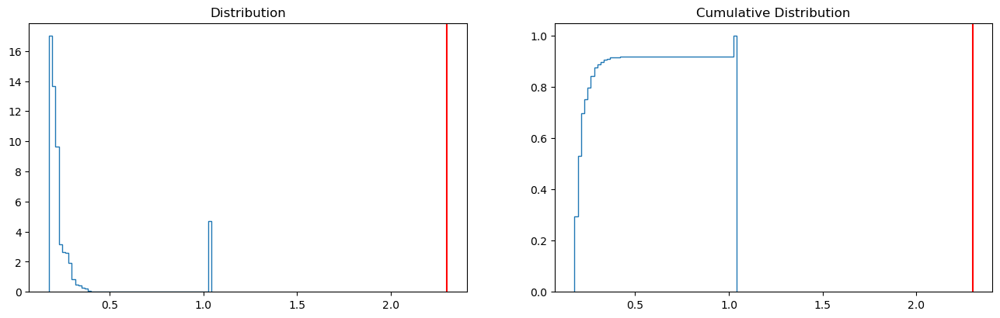

In [60]:
fig, ax = plt.subplots(1, 2, figsize=[16,4.5])
ax[0].hist(cov_emp.mahalanobis(X), bins=50, density=True, histtype='step')
ax[0].axvline(x=2.3, color='r')
ax[0].set_title('Distribution')
ax[1].hist(cov_emp.mahalanobis(X), bins=50, density=True, cumulative=True, histtype='step')
ax[1].axvline(x=2.3, color='r')
ax[1].set_title('Cumulative Distribution')

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-24.582676718335726 > -85.270126240525684). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-24.681552932905586 > -85.271464572774946). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_robust_covariance.py:184: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (-24.586487033379058 > -85.268906163285067). You may want to try with a higher value of support_fraction (current value: 0.501).

/opt/conda/lib/python3.10/site-packages/sklearn/covariance/_r

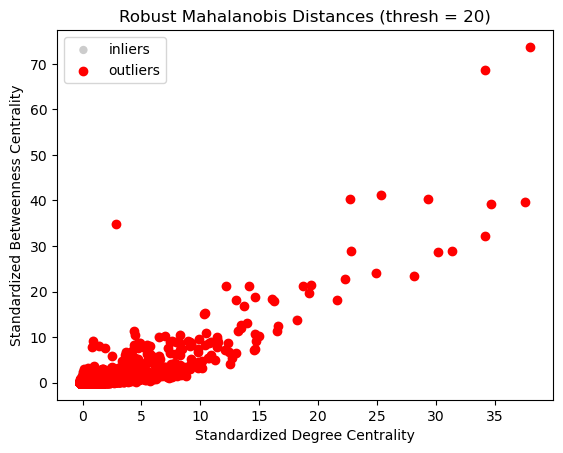

In [84]:
eigenvector_centrality = nx.eigenvector_centrality(G)
X = np.array([
    [degree_centrality[node], betweenness_centrality[node], closeness_centrality[node], eigenvector_centrality[node]]
    for node in G.nodes()
])
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

cov_emp = MinCovDet().fit(X_scaled)
robust_mahal_dist = cov_emp.mahalanobis(X_scaled)

thres = 20
outliers = np.where(robust_mahal_dist >= thres)[0]

plt.scatter(X_scaled[:, 0], X_scaled[:, 1], color='black', label='inliers', alpha=0.2, edgecolors='none')
plt.scatter(X_scaled[outliers, 0], X_scaled[outliers, 1], color='red', label='outliers')
plt.title(f"Robust Mahalanobis Distances (thresh = {thres})")
plt.xlabel("Standardized Degree Centrality")
plt.ylabel("Standardized Betweenness Centrality")
plt.legend()
plt.show()

In [87]:
eigenvector_centrality

{0: 1.1957867555048304e-05,
 1: 0.0014155149596769515,
 2: 1.1957867555048304e-05,
 3: 0.0002618934230655117,
 4: 0.0008196664839137205,
 5: 0.015748911027832532,
 6: 0.0012886349843535538,
 7: 0.0027257941432870417,
 8: 1.1957867555048304e-05,
 9: 0.005811467530465571,
 10: 3.4034875003359455e-05,
 11: 0.0004560677748688453,
 12: 0.0004560677748688453,
 13: 0.0017015725078133436,
 14: 1.1957867555048304e-05,
 15: 0.0007397009950975649,
 16: 0.0007235849534258799,
 17: 1.1957867555048304e-05,
 18: 0.0012125823036217183,
 19: 1.3514974722351694e-05,
 20: 1.1957867555048304e-05,
 21: 0.0005145307836275051,
 22: 1.1957867555048304e-05,
 23: 1.1957867555048304e-05,
 24: 1.1957867555048304e-05,
 25: 0.00043755496325798064,
 26: 1.1957867555048304e-05,
 27: 0.02421220547161793,
 28: 1.1957867555048304e-05,
 29: 1.1957867555048304e-05,
 30: 1.2227324339419444e-05,
 31: 1.3514974722351694e-05,
 32: 1.2227324339419444e-05,
 33: 1.1957867555048304e-05,
 34: 1.1957867555048304e-05,
 35: 0.0002340

In [89]:
# Create a DataFrame from the eigenvector centrality dictionary
eigencentrality_df = pd.DataFrame({'Node': list(eigenvector_centrality.keys()),
                                   'EigenvectorCentrality': list(eigenvector_centrality.values())})

# Display the DataFrame
eigencentrality_df.to_csv('eigencentrality_enron.csv')

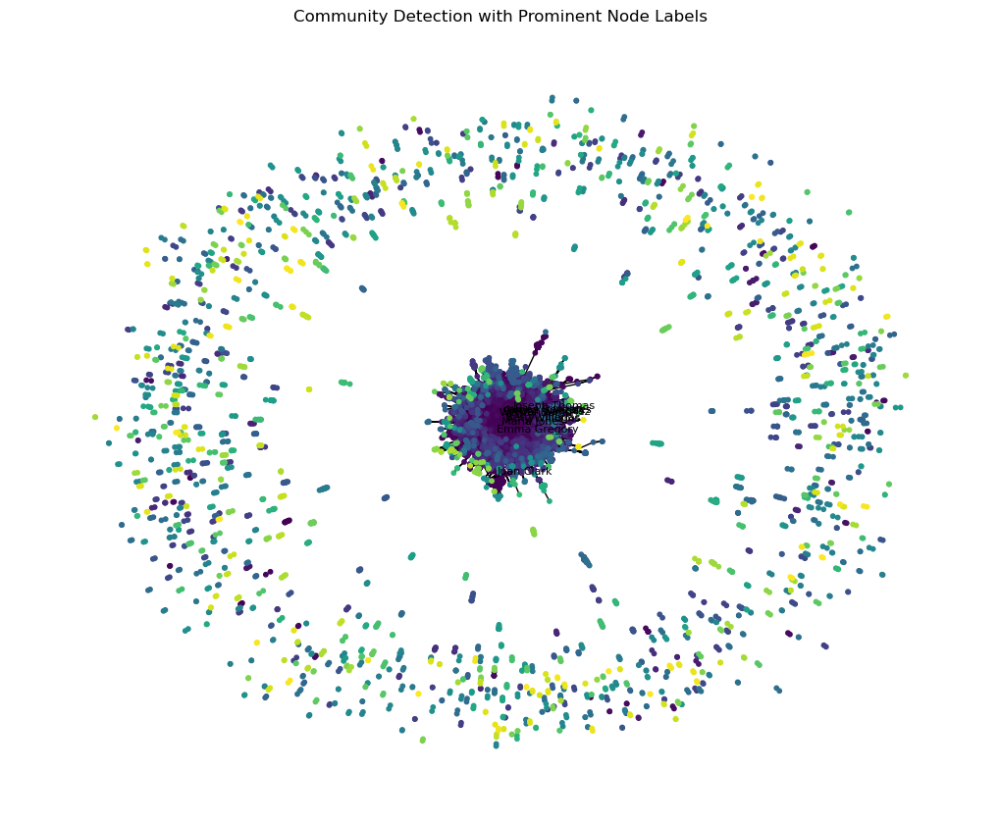

In [49]:
# Identify the most prominent nodes
most_prominent_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:10]

# Create a dictionary to map node IDs to names
node_id_to_name = {node_id: node_name for node_id, node_name in zip(df_named['FromNodeId'], df_named['FromNodeName'])}

# Detect communities
communities = community.greedy_modularity_communities(G)
community_colors = [i for i, _ in enumerate(communities) for _ in communities[i]]

# Create the plot
plt.figure(figsize=(10, 8))
pos = nx.spring_layout(G)  # You might need to adjust the layout algorithm
nx.draw(G, pos, node_color=community_colors, node_size=10, with_labels=False)  # Turn off default labels

# Label the most prominent nodes
for node in most_prominent_nodes:
    plt.text(pos[node][0], pos[node][1], node_id_to_name.get(node, ""), fontsize=8)

# Save the plot as an image file (e.g., PNG)
plt.title("Community Detection with Prominent Node Labels")
plt.savefig("community_detection_labels.png", dpi=300)  # Change the file format and DPI as needed
plt.show()

In [41]:
most_prominent_nodes

[5038, 273, 458, 140, 1028, 195, 370, 1139, 136, 566]

In [44]:
for node in most_prominent_nodes:
    print(df_named['FromNodeName'][node])

Shannon Chambers
Caitlin Stewart
Peter Mclaughlin
Mr. Eric Hickman MD
Jason Bennett
Chad Cox
Victor Richardson
Erik Barrett
Courtney Lucas
Sheryl Ortiz


In [45]:
for node in top_nodes:
    print(df_named['FromNodeName'][node])

Shannon Chambers
Caitlin Stewart
Peter Mclaughlin
Mr. Eric Hickman MD
Jason Bennett
Chad Cox
Victor Richardson
Erik Barrett
Courtney Lucas
Sheryl Ortiz


## References
Stanford Network Analysis Project (SNAP). (n.d.). Enron Email Communication Dataset. Retrieved from https://snap.stanford.edu/data/email-Enron.html

In [90]:
df_named

,#,FromNodeId,FromNodeName
0,0,1,Carla Grimes
1,1,0,Kenneth Hogan
2,1,2,Donald Hahn
3,1,3,Debbie Jones
4,1,4,Stephen Bailey
...,...,...,...
367657,36688,36686,Craig White
367658,36688,36687,Stacy Gonzalez
367659,36689,36690,Vincent House
367660,36690,36689,Michael Rice


In [91]:
df_named.to_csv('df_named.csv')